In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import warnings # Import the warnings module


import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.preprocessing.image import load_img, array_to_img, img_to_array
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')


In [ ]:
##LOad Files

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle

In [ ]:
!kaggle datasets download -d soumikrakshit/anime-faces

Dataset URL: https://www.kaggle.com/datasets/soumikrakshit/anime-faces
License(s): unknown
100% 439M/441M [00:16<00:00, 29.8MB/s]
100% 441M/441M [00:16<00:00, 28.0MB/s]


In [ ]:
import zipfile
zip_ref = zipfile.ZipFile('/content/anime-faces.zip','r')
zip_ref.extractall('/content/anime-face')
zip_ref.close()

In [ ]:
BASE_DIR = "/content/anime-face/data/"


In [ ]:
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [ ]:
image_paths[:5]

['/content/anime-face/data/12940.png',
 '/content/anime-face/data/12487.png',
 '/content/anime-face/data/17939.png',
 '/content/anime-face/data/19112.png',
 '/content/anime-face/data/4501.png']

In [ ]:
image_paths.remove("/content/anime-face/data/data")

In [ ]:
len(image_paths)

21551

In [ ]:
#display grid of images

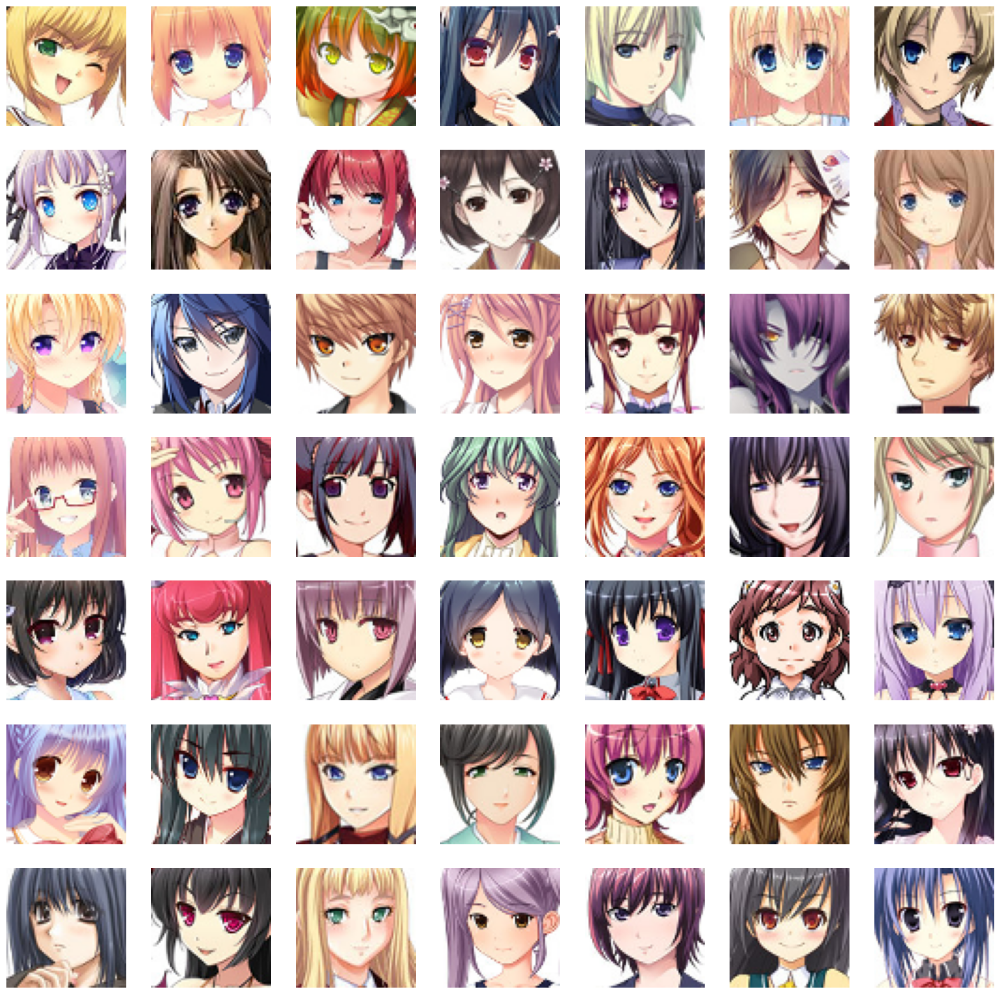

In [ ]:
plt.figure(figsize=(20,20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7,7,index)
    img = load_img(image_path)
    img = np.array(img)

    plt.imshow(img)
    plt.axis('off')
    index += 1


In [ ]:
#preprocess images

train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [ ]:
train_images[0].shape

(64, 64, 3)

In [ ]:
#reshape the array

train_images = train_images.reshape(train_images.shape[0],64,64,3).astype('float32')

In [ ]:
#normalise the images

train_images = (train_images - 127.5 )/127.5

In [ ]:
train_images[0]

array([[[-0.7647059 , -0.73333335, -0.7254902 ],
        [-0.5372549 , -0.6392157 , -0.7254902 ],
        [ 0.654902  ,  0.24705882, -0.18431373],
        ...,
        [ 0.9529412 ,  0.70980394,  0.00392157],
        [ 0.9529412 ,  0.7019608 ,  0.01176471],
        [ 0.9529412 ,  0.7254902 ,  0.02745098]],

       [[-0.70980394, -0.70980394, -0.7647059 ],
        [ 0.6392157 ,  0.21568628, -0.14509805],
        [ 0.5764706 ,  0.23921569, -0.37254903],
        ...,
        [ 0.9607843 ,  0.7176471 ,  0.01176471],
        [ 0.9529412 ,  0.7254902 , -0.00392157],
        [ 0.94509804,  0.70980394, -0.01960784]],

       [[ 0.6       ,  0.16078432, -0.33333334],
        [ 0.58431375,  0.27058825, -0.22352941],
        [ 0.64705884,  0.43529412, -0.10588235],
        ...,
        [ 0.94509804,  0.69411767,  0.00392157],
        [ 0.96862745,  0.7019608 ,  0.05098039],
        [ 0.9843137 ,  0.73333335,  0.00392157]],

       ...,

       [[ 0.52156866,  0.19215687, -0.33333334],
        [ 0

#create Generator and Discriminators

In [ ]:
#latent dimension for random noise
LATENT_DIM = 100
#weight initialisation
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
#no of chanels of image
CHANNELS = 3 #for grey scale, keep it as 1



##Gernerator model

generator model make a model similar to training data from random noise

In [ ]:


model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 32768)               │       3,309,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu (ReLU)                         │ (None, 32768)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_1 (ReLU)                       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_2 (ReLU)                       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 64, 64, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_3 (ReLU)                       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 64, 64, 3)           │           3,075 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

##Discrminator model

discriminator model will classify the image from the generator check whether the image is real or not

In [ ]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)                    │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 8, 8, 128)           │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │           8,193 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

###create DCGAN

In [ ]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}



In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [ ]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [ ]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step - d_loss: 1.3872 - g_loss: 1.7213

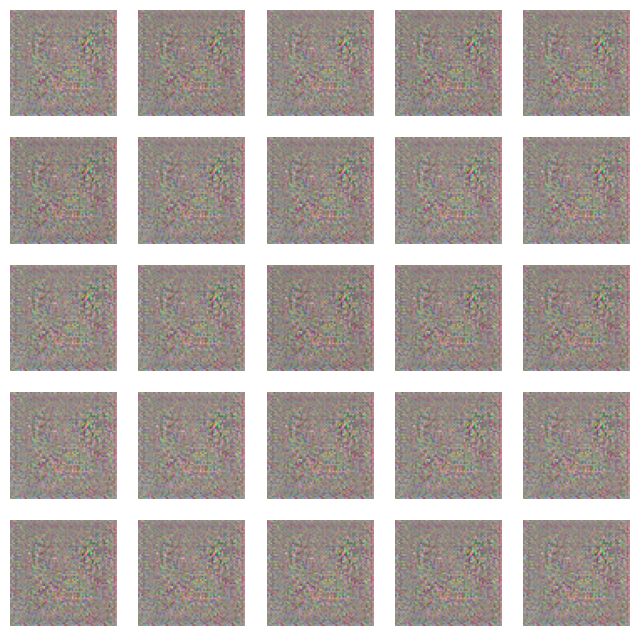

674/674 ━━━━━━━━━━━━━━━━━━━━ 73s 79ms/step - d_loss: 1.3861 - g_loss: 1.7227
Epoch 2/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1295 - g_loss: 3.4630

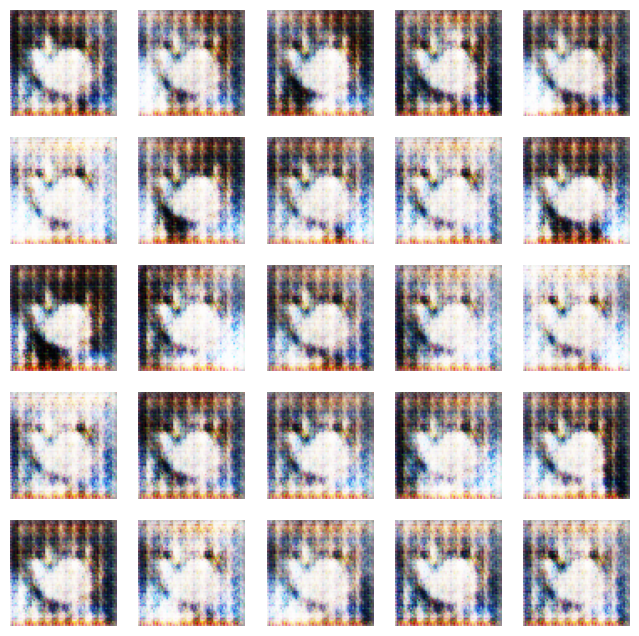

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.1302 - g_loss: 3.4609
Epoch 3/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.5579 - g_loss: 1.7980

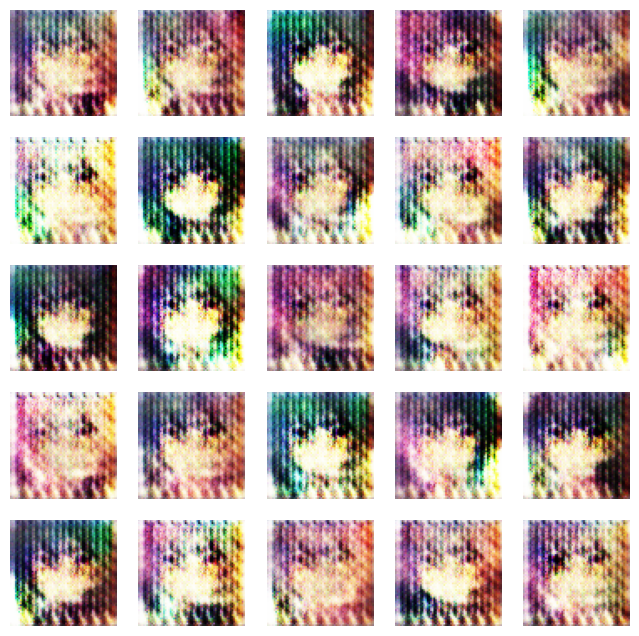

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.5580 - g_loss: 1.7978
Epoch 4/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.5939 - g_loss: 1.6560

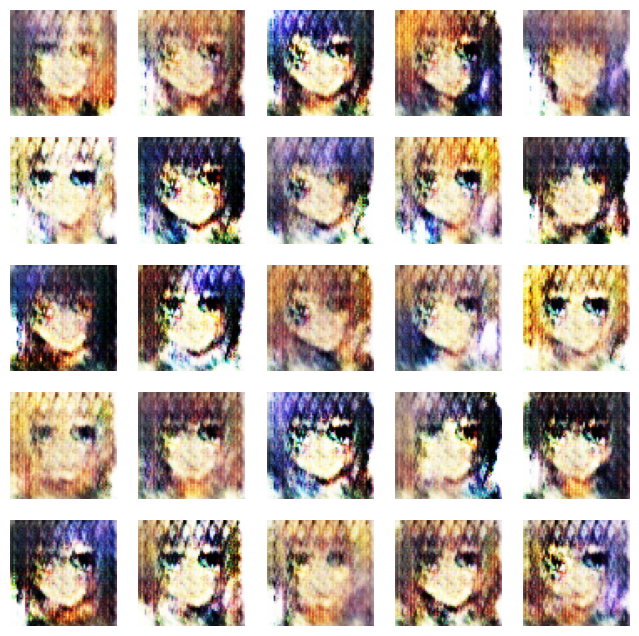

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.5938 - g_loss: 1.6559
Epoch 5/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6330 - g_loss: 1.5903

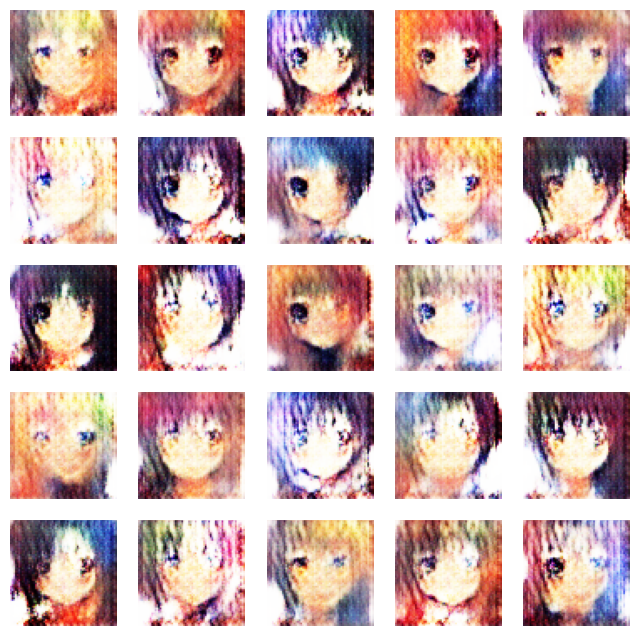

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.6329 - g_loss: 1.5902
Epoch 6/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.6189 - g_loss: 1.5126

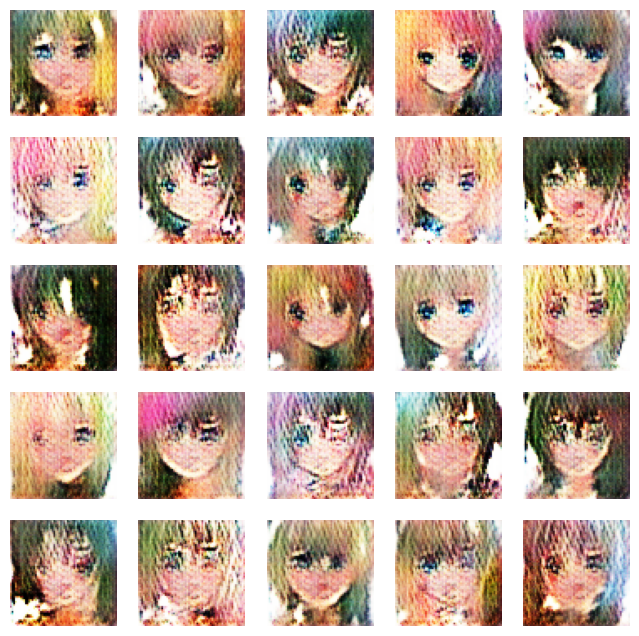

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.6190 - g_loss: 1.5124
Epoch 7/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6794 - g_loss: 1.1863

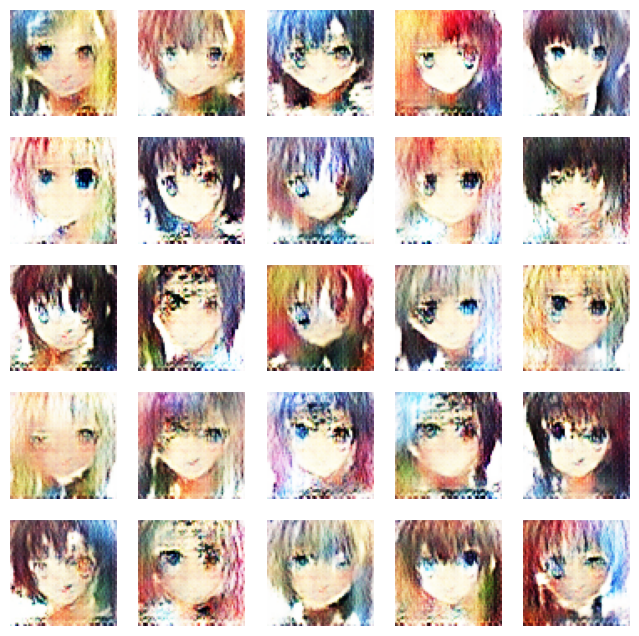

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 66ms/step - d_loss: 0.6794 - g_loss: 1.1861
Epoch 8/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.7137 - g_loss: 0.9815

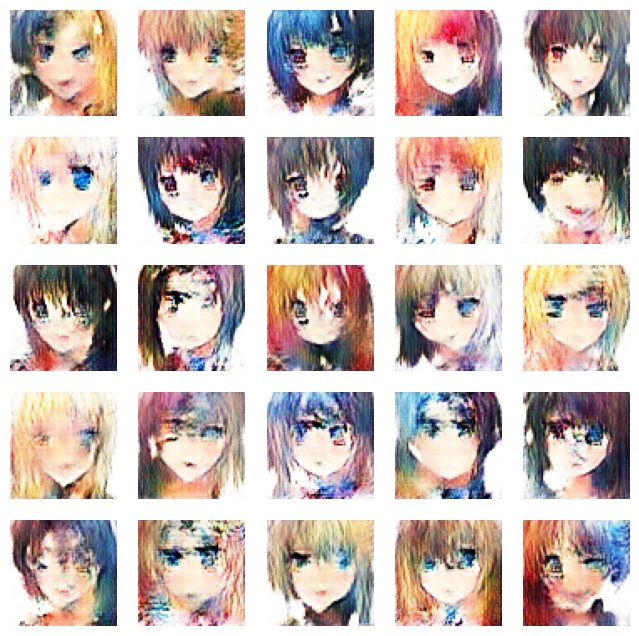

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 66ms/step - d_loss: 0.7137 - g_loss: 0.9815
Epoch 9/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6775 - g_loss: 0.9896

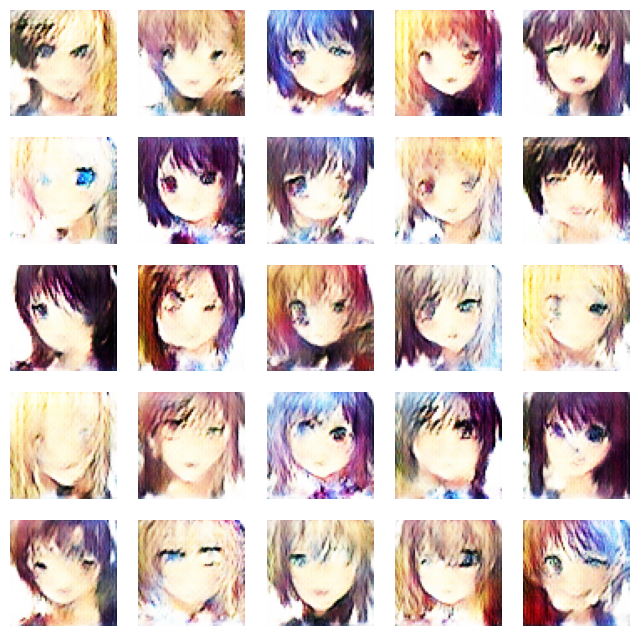

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.6774 - g_loss: 0.9898
Epoch 10/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6786 - g_loss: 0.9955

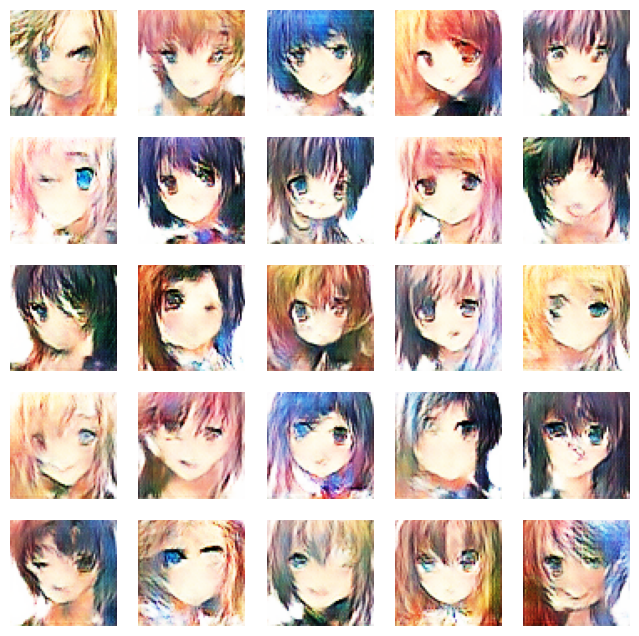

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.6786 - g_loss: 0.9953
Epoch 11/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.7195 - g_loss: 0.8892

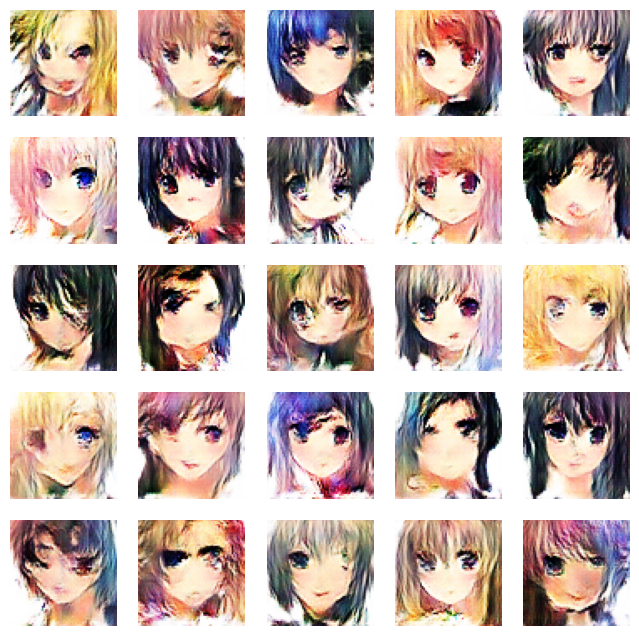

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.7195 - g_loss: 0.8891
Epoch 12/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.7272 - g_loss: 0.8171

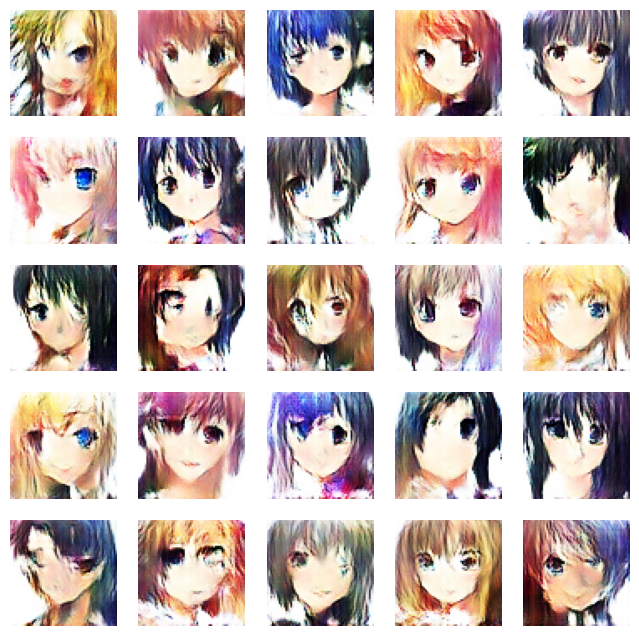

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 65ms/step - d_loss: 0.7272 - g_loss: 0.8171
Epoch 13/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.7250 - g_loss: 0.7856

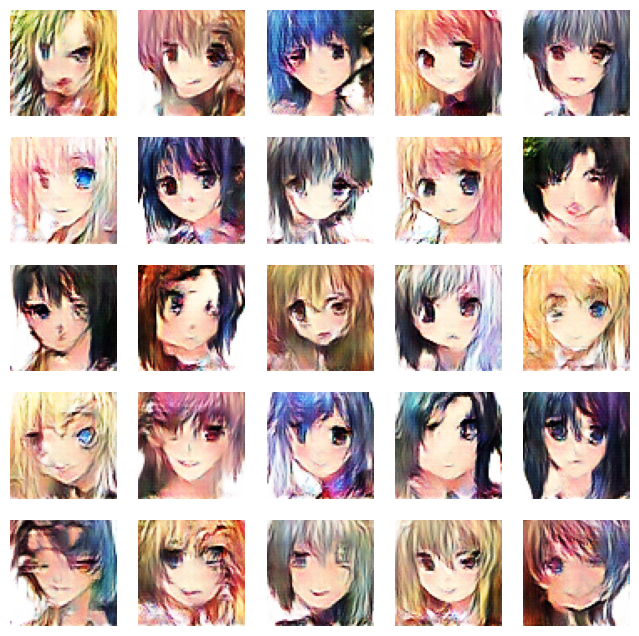

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 66ms/step - d_loss: 0.7250 - g_loss: 0.7856
Epoch 14/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.7274 - g_loss: 0.7592

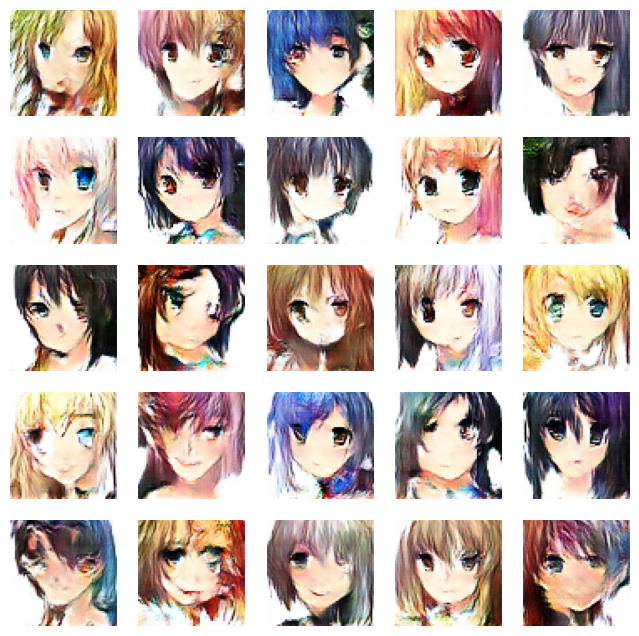

674/674 ━━━━━━━━━━━━━━━━━━━━ 81s 65ms/step - d_loss: 0.7274 - g_loss: 0.7592
Epoch 15/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.7193 - g_loss: 0.7397

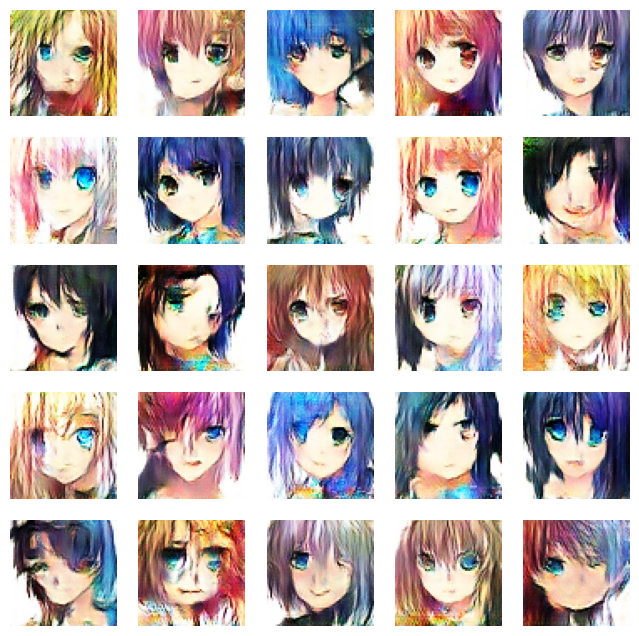

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.7193 - g_loss: 0.7397
Epoch 16/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.7161 - g_loss: 0.7358

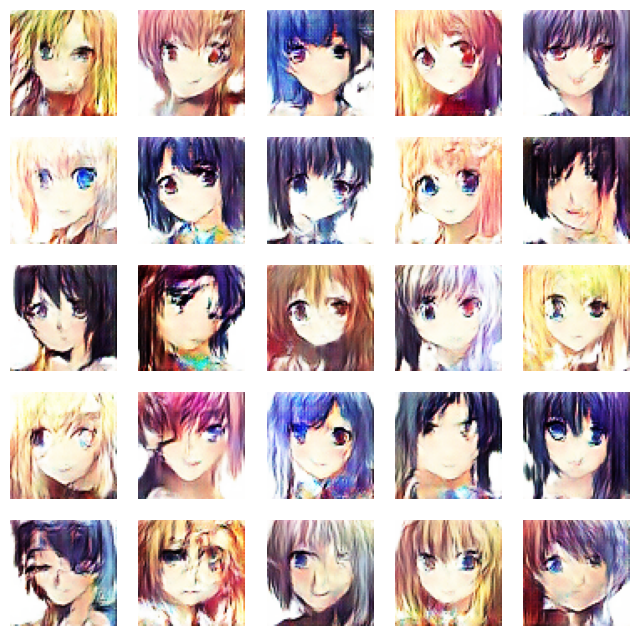

674/674 ━━━━━━━━━━━━━━━━━━━━ 44s 65ms/step - d_loss: 0.7161 - g_loss: 0.7358
Epoch 17/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.7148 - g_loss: 0.7399

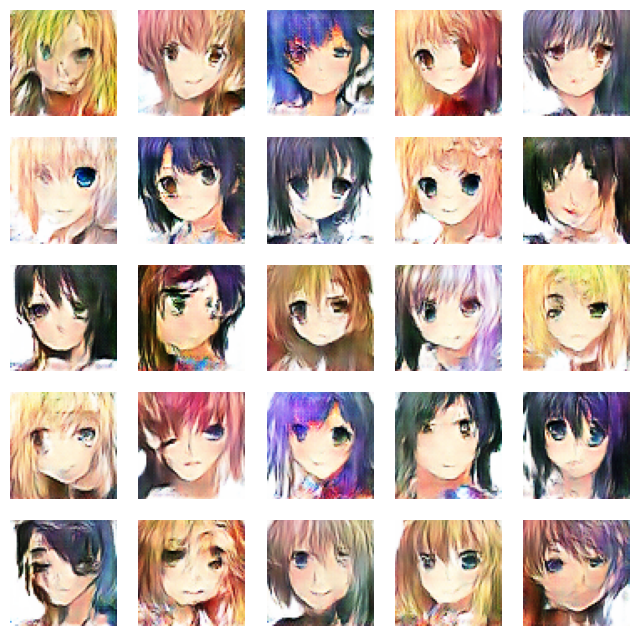

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.7148 - g_loss: 0.7399
Epoch 18/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.7102 - g_loss: 0.7281

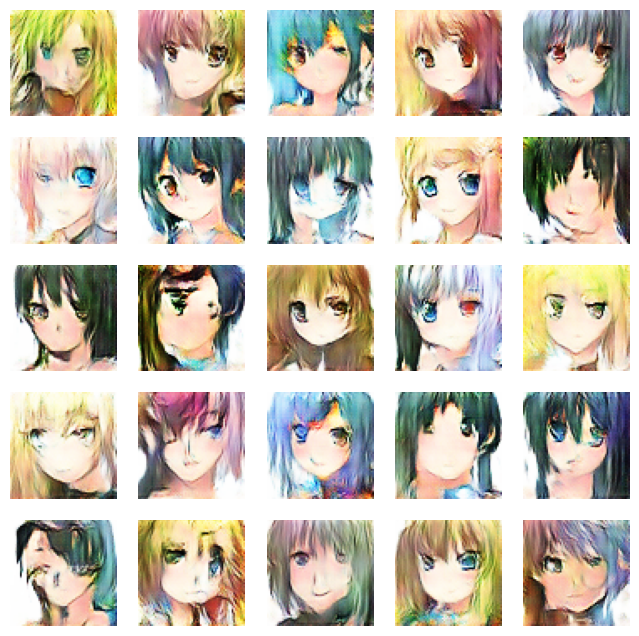

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.7102 - g_loss: 0.7281
Epoch 19/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.7089 - g_loss: 0.7256

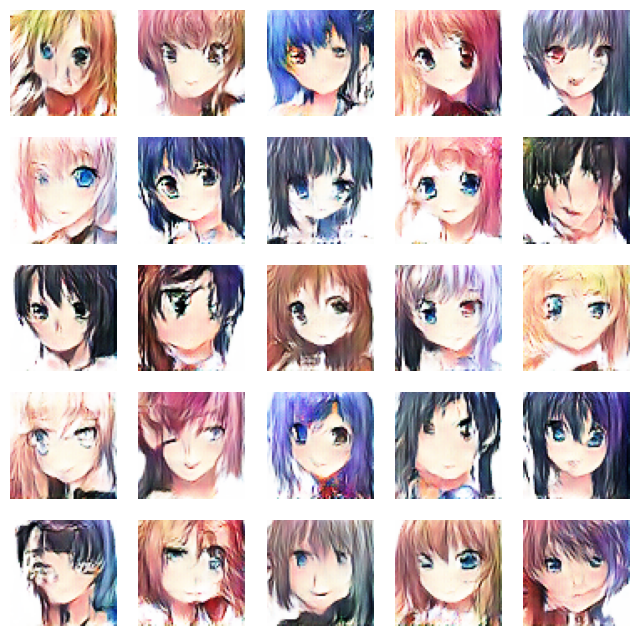

674/674 ━━━━━━━━━━━━━━━━━━━━ 44s 65ms/step - d_loss: 0.7089 - g_loss: 0.7256
Epoch 20/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.7053 - g_loss: 0.7331

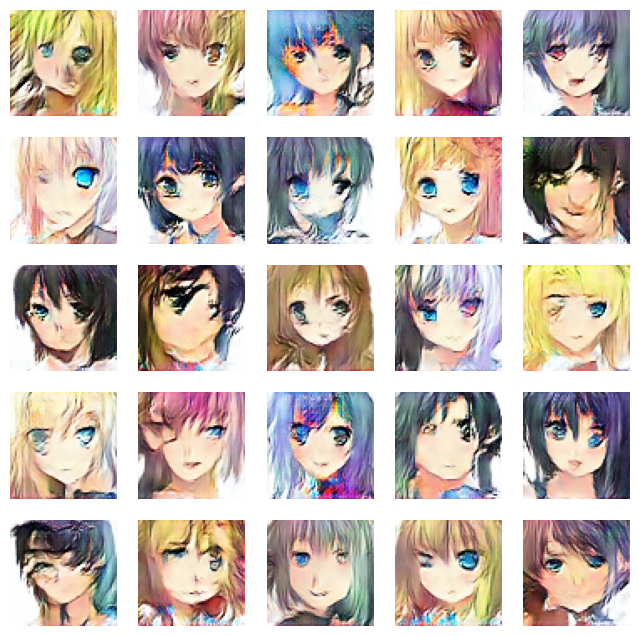

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.7053 - g_loss: 0.7331
Epoch 21/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.7028 - g_loss: 0.7280

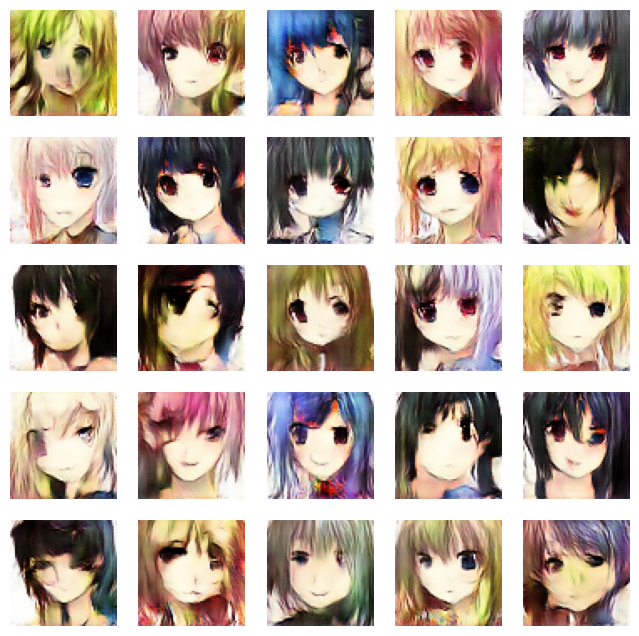

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 65ms/step - d_loss: 0.7028 - g_loss: 0.7280
Epoch 22/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.7051 - g_loss: 0.7297

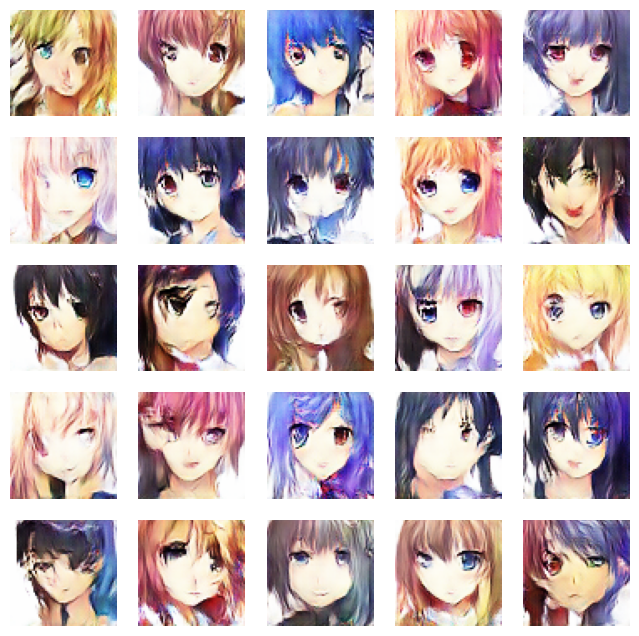

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.7051 - g_loss: 0.7297
Epoch 23/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.7011 - g_loss: 0.7281

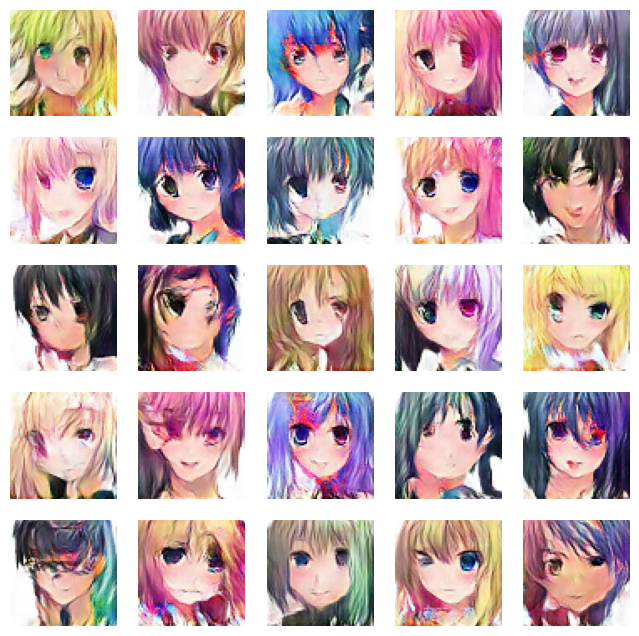

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.7011 - g_loss: 0.7281
Epoch 24/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6989 - g_loss: 0.7307

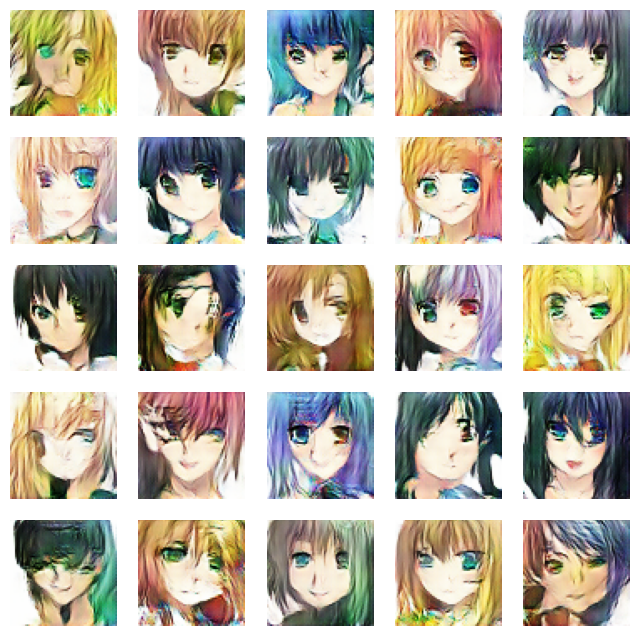

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.6989 - g_loss: 0.7307
Epoch 25/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.7012 - g_loss: 0.7361

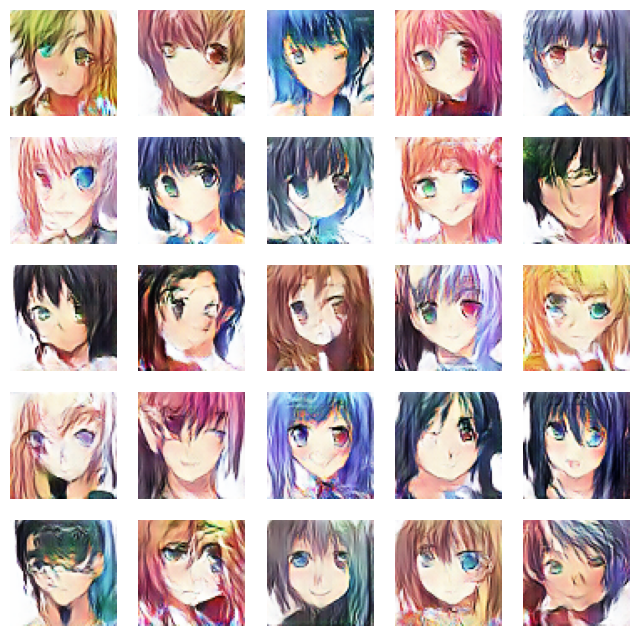

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 66ms/step - d_loss: 0.7012 - g_loss: 0.7361
Epoch 26/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6993 - g_loss: 0.7264

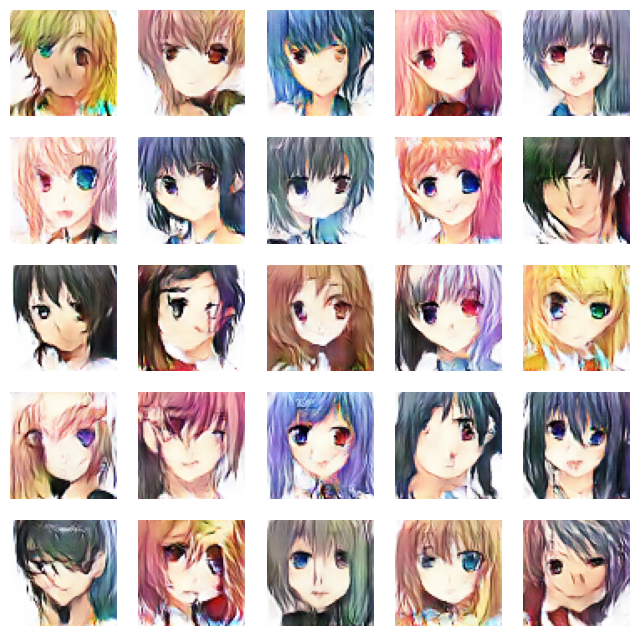

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.6993 - g_loss: 0.7264
Epoch 27/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6966 - g_loss: 0.7331

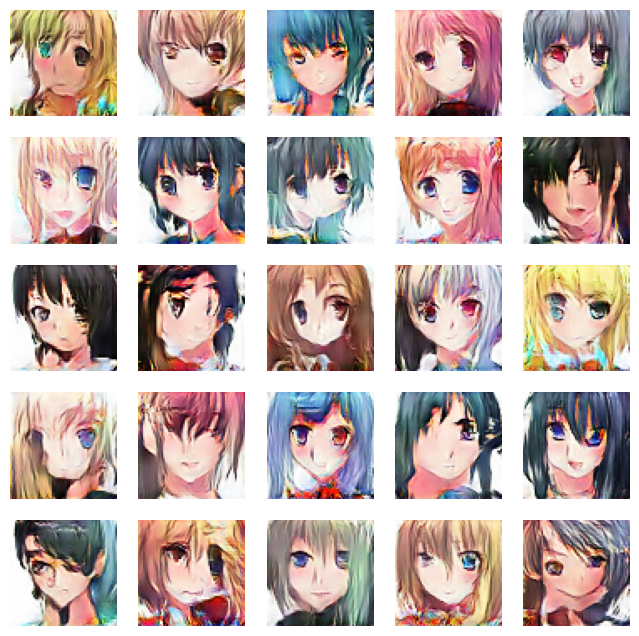

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.6966 - g_loss: 0.7331
Epoch 28/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6933 - g_loss: 0.7404

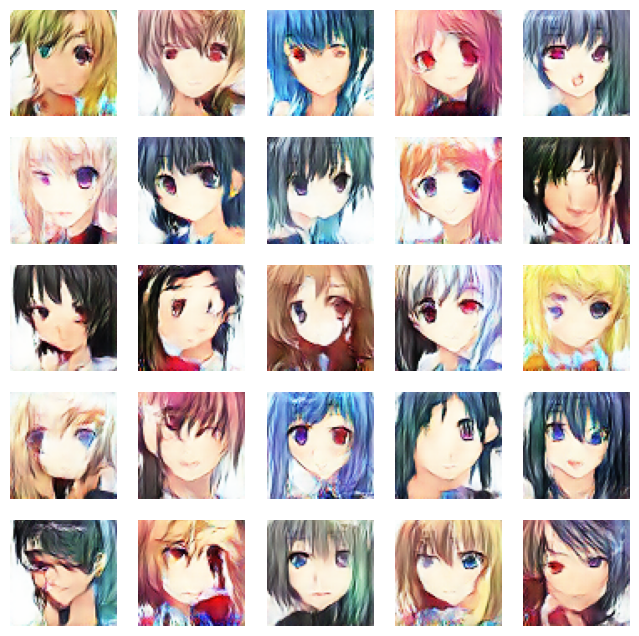

674/674 ━━━━━━━━━━━━━━━━━━━━ 44s 65ms/step - d_loss: 0.6933 - g_loss: 0.7404
Epoch 29/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6909 - g_loss: 0.7398

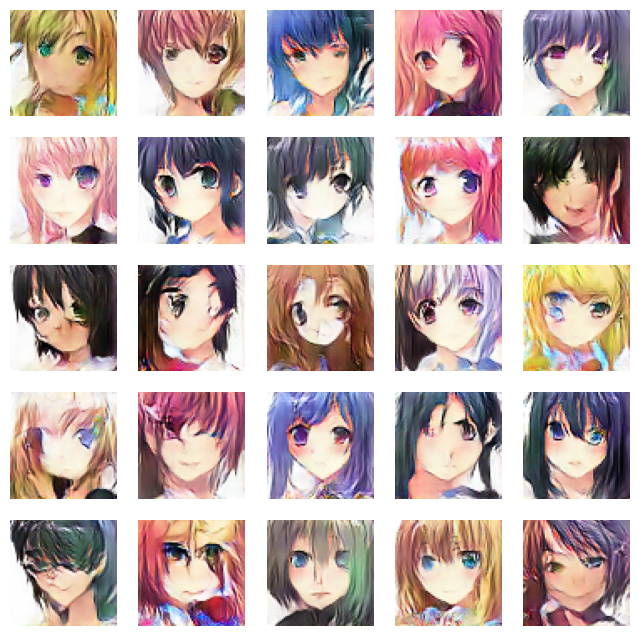

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.6909 - g_loss: 0.7397
Epoch 30/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6932 - g_loss: 0.7468

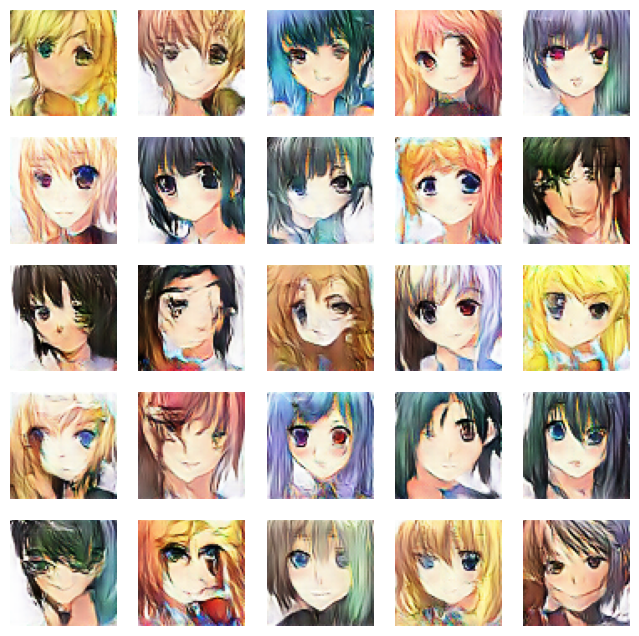

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 64ms/step - d_loss: 0.6932 - g_loss: 0.7468
Epoch 31/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6884 - g_loss: 0.7537

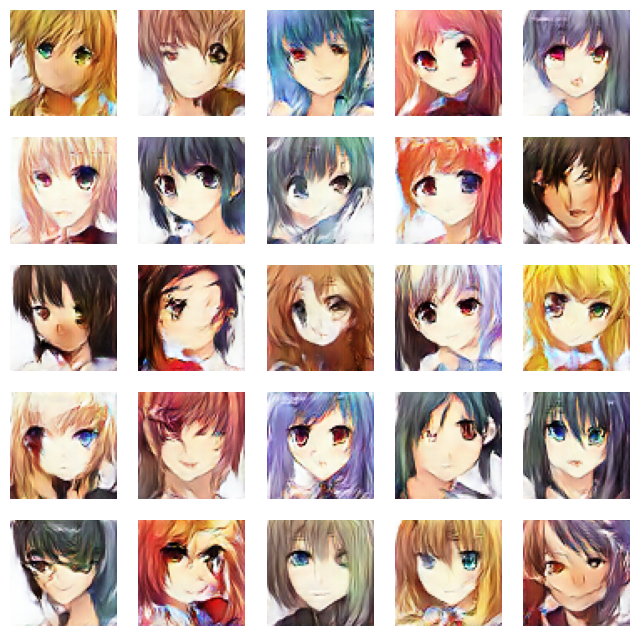

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.6884 - g_loss: 0.7537
Epoch 32/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.6869 - g_loss: 0.7584

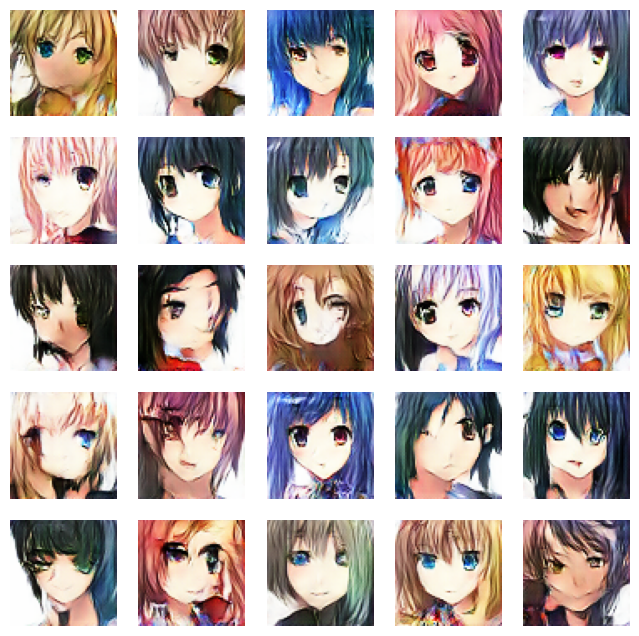

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 66ms/step - d_loss: 0.6869 - g_loss: 0.7584
Epoch 33/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6840 - g_loss: 0.7618

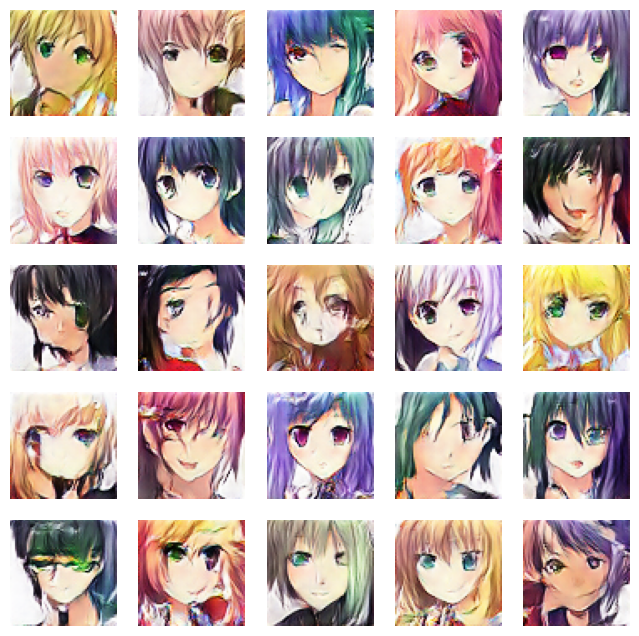

674/674 ━━━━━━━━━━━━━━━━━━━━ 81s 65ms/step - d_loss: 0.6840 - g_loss: 0.7618
Epoch 34/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6816 - g_loss: 0.7687

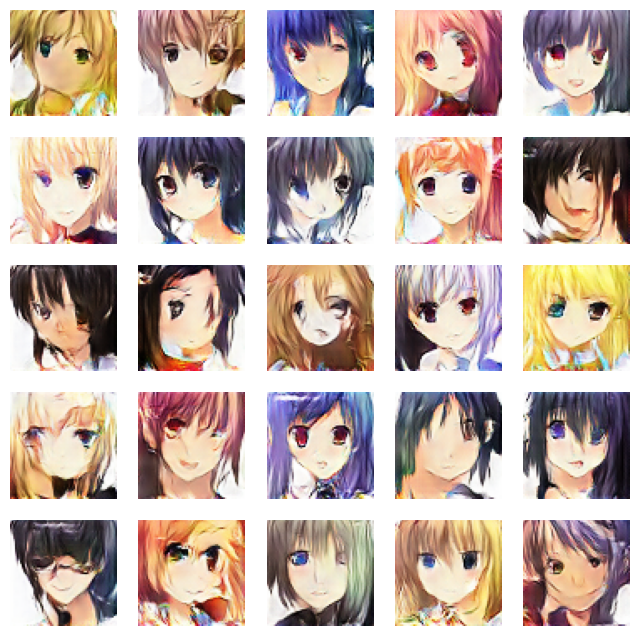

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.6816 - g_loss: 0.7687
Epoch 35/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6807 - g_loss: 0.7804

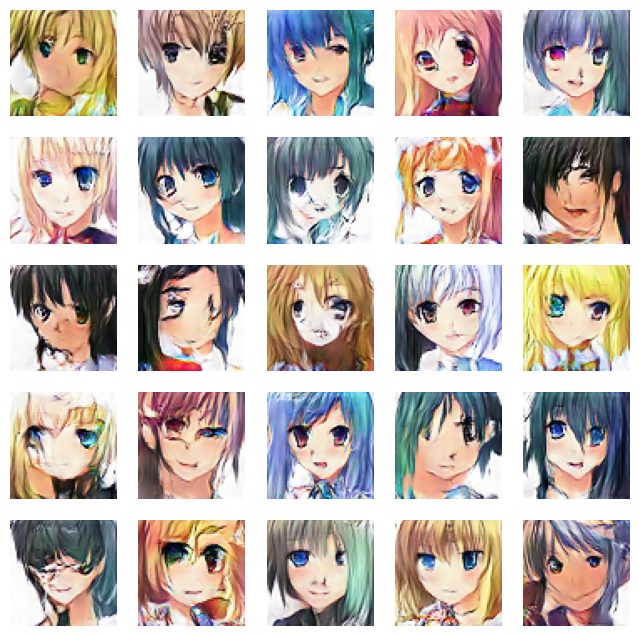

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.6807 - g_loss: 0.7804
Epoch 36/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6777 - g_loss: 0.7845

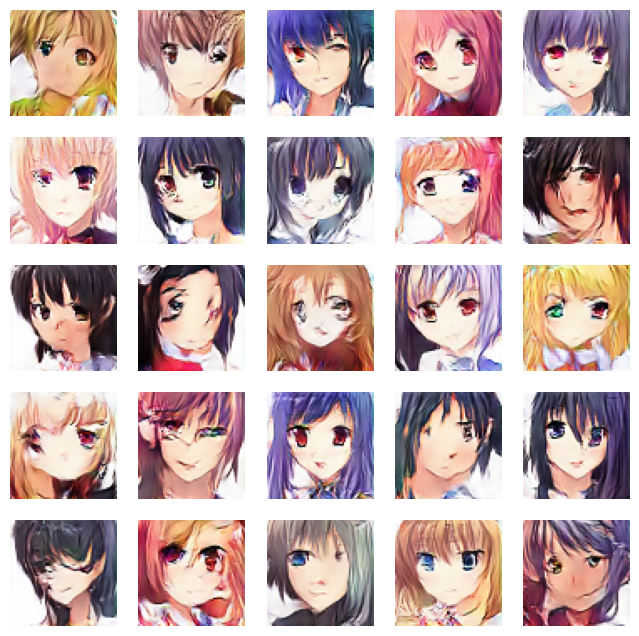

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.6777 - g_loss: 0.7845
Epoch 37/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6705 - g_loss: 0.7908

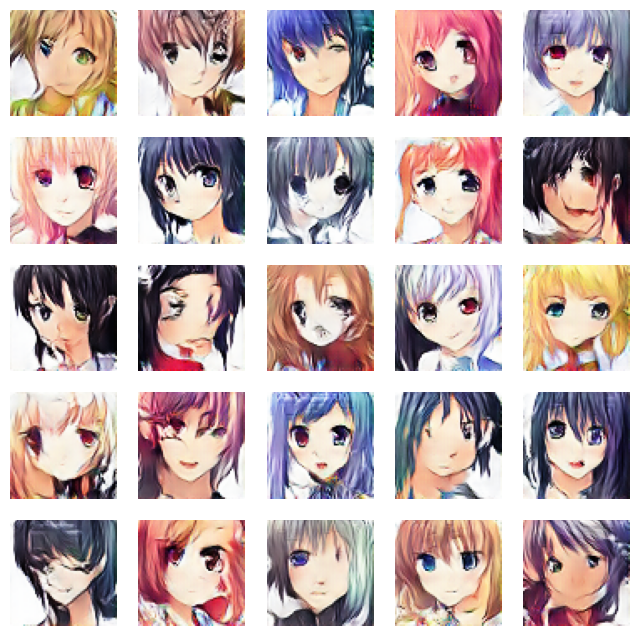

674/674 ━━━━━━━━━━━━━━━━━━━━ 85s 69ms/step - d_loss: 0.6705 - g_loss: 0.7908
Epoch 38/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6713 - g_loss: 0.8021

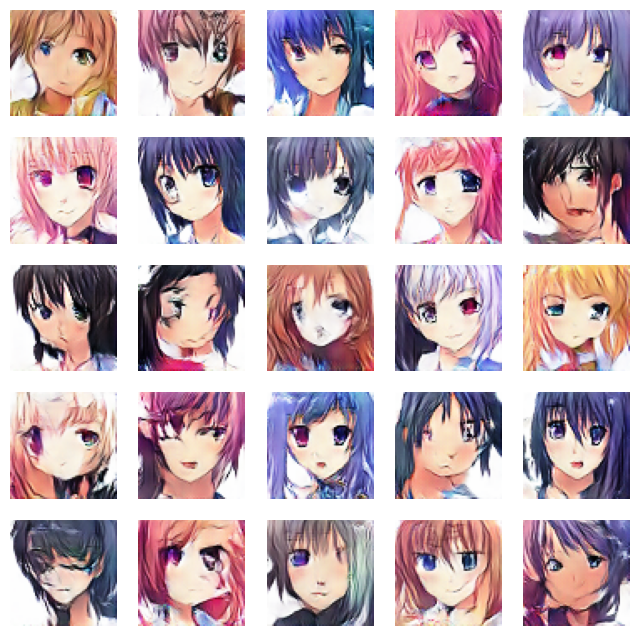

674/674 ━━━━━━━━━━━━━━━━━━━━ 79s 65ms/step - d_loss: 0.6713 - g_loss: 0.8021
Epoch 39/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6662 - g_loss: 0.8210

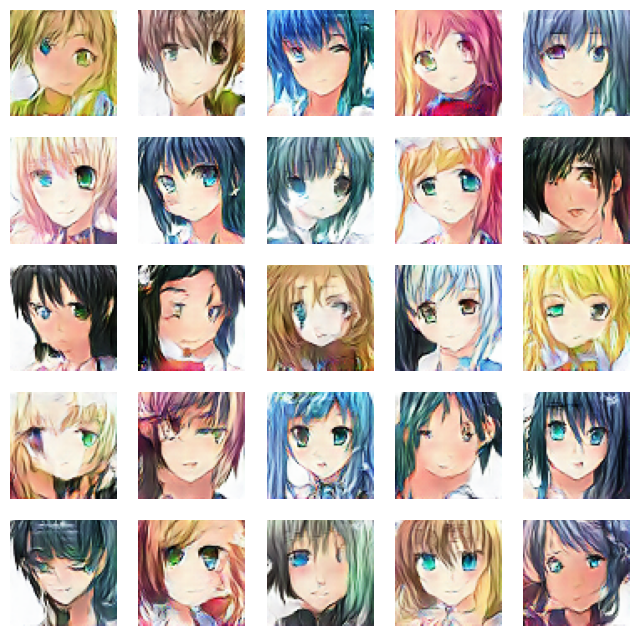

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 65ms/step - d_loss: 0.6662 - g_loss: 0.8210
Epoch 40/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6583 - g_loss: 0.8280

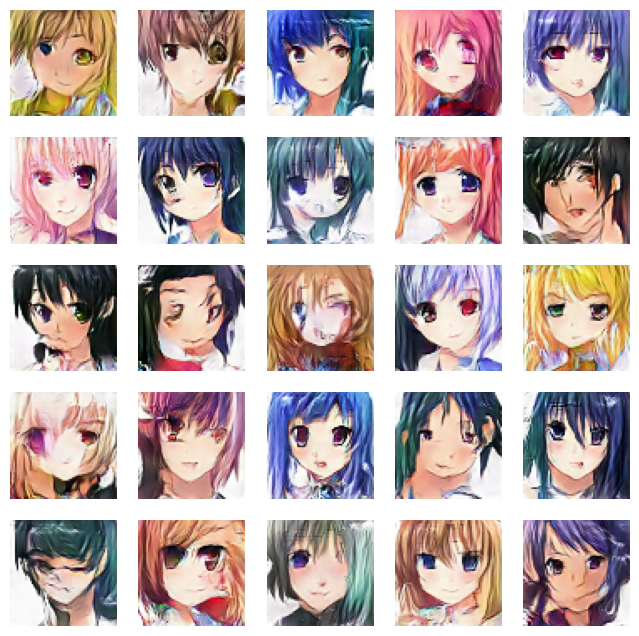

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.6583 - g_loss: 0.8280
Epoch 41/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.6567 - g_loss: 0.8461

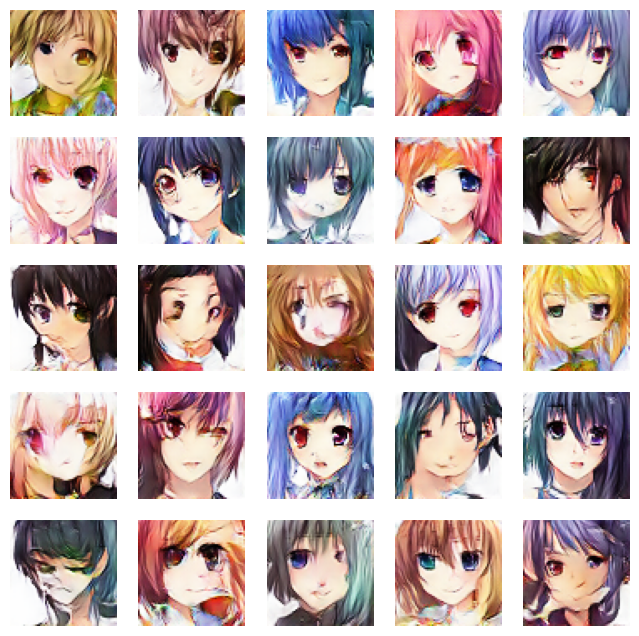

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 66ms/step - d_loss: 0.6567 - g_loss: 0.8461
Epoch 42/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6532 - g_loss: 0.8526

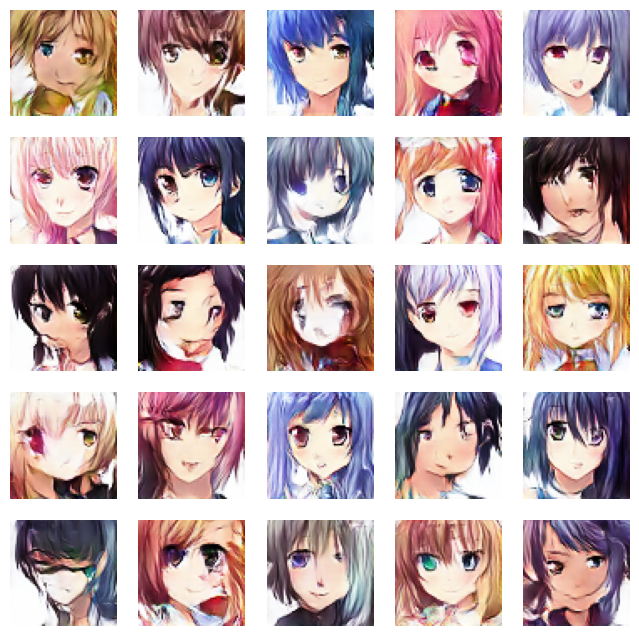

674/674 ━━━━━━━━━━━━━━━━━━━━ 81s 64ms/step - d_loss: 0.6532 - g_loss: 0.8526
Epoch 43/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6459 - g_loss: 0.8758

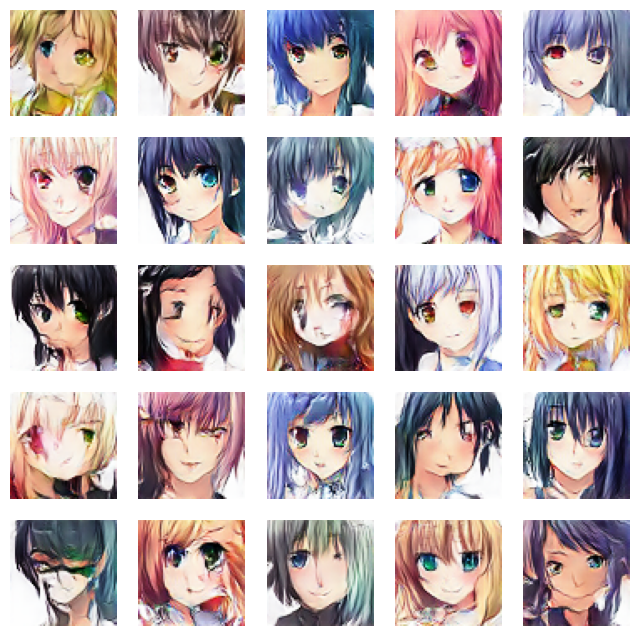

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.6459 - g_loss: 0.8758
Epoch 44/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6414 - g_loss: 0.8845

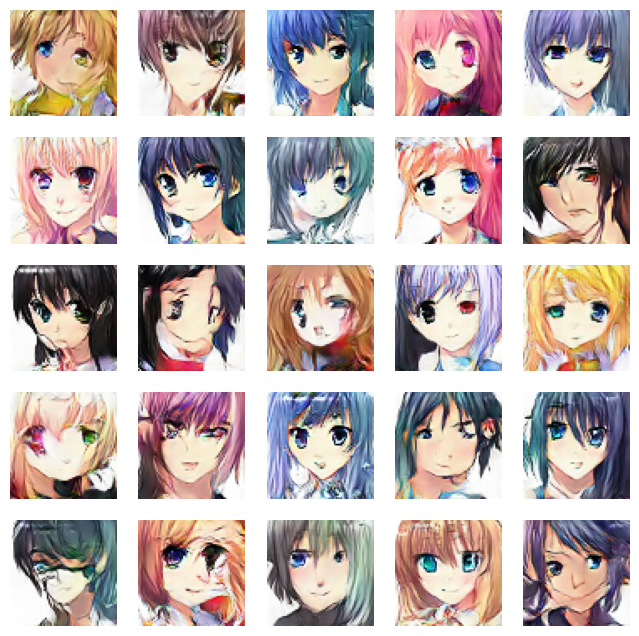

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 65ms/step - d_loss: 0.6414 - g_loss: 0.8845
Epoch 45/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6312 - g_loss: 0.9084

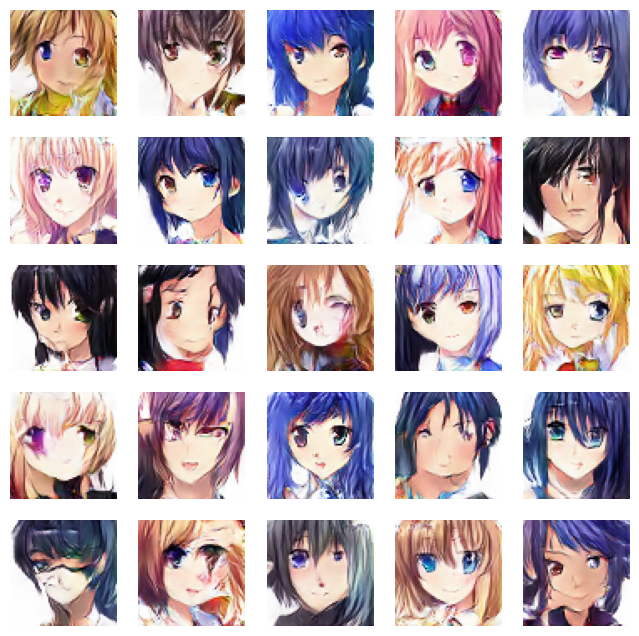

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.6312 - g_loss: 0.9084
Epoch 46/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6273 - g_loss: 0.9270

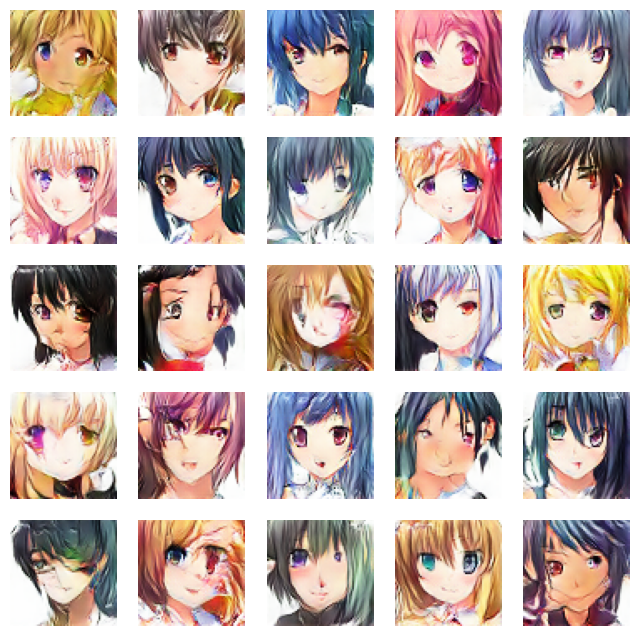

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.6273 - g_loss: 0.9270
Epoch 47/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6239 - g_loss: 0.9418

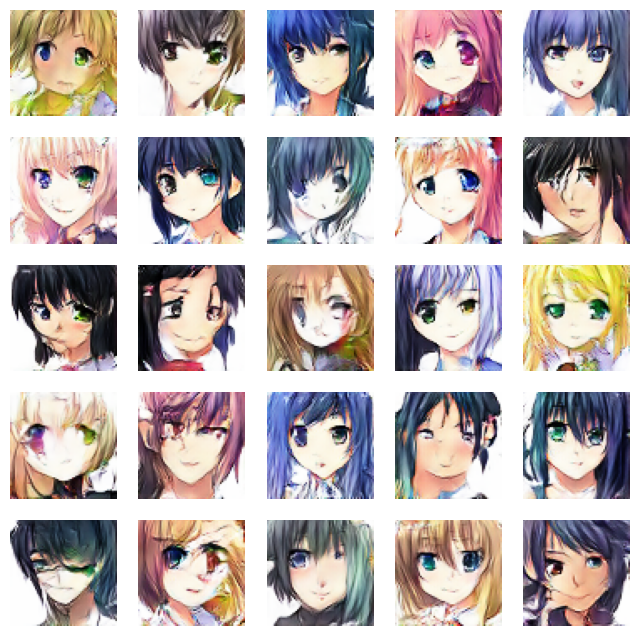

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 65ms/step - d_loss: 0.6239 - g_loss: 0.9418
Epoch 48/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6206 - g_loss: 0.9614

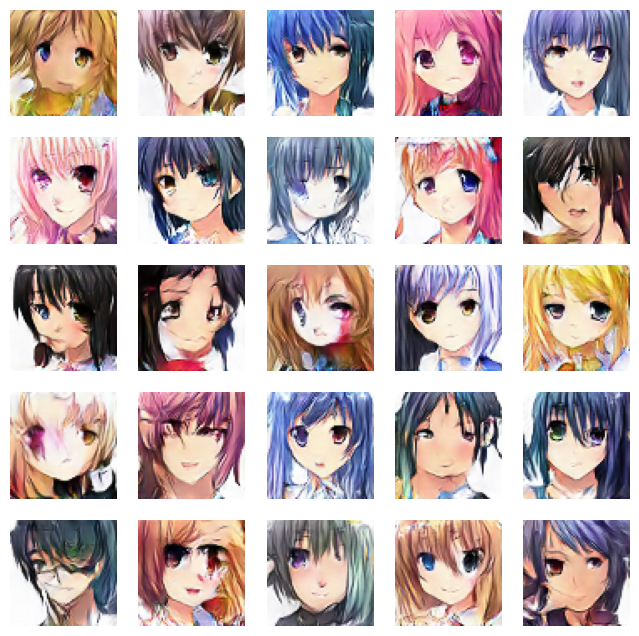

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.6206 - g_loss: 0.9614
Epoch 49/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6157 - g_loss: 0.9688

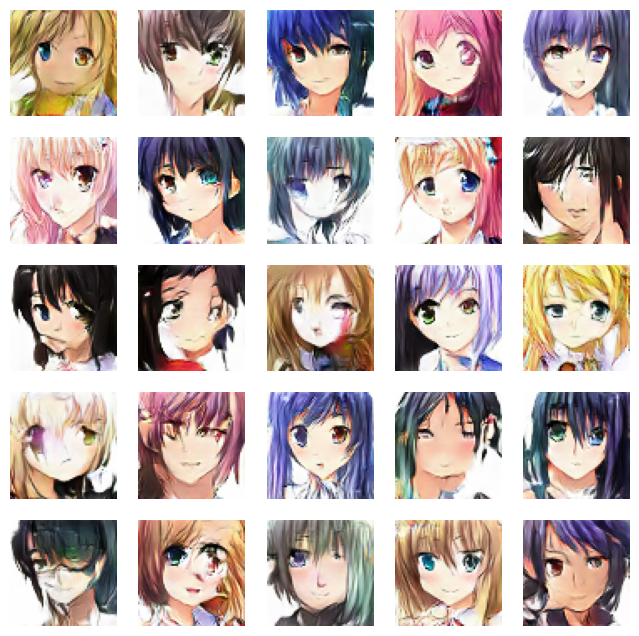

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.6157 - g_loss: 0.9688
Epoch 50/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6113 - g_loss: 0.9885

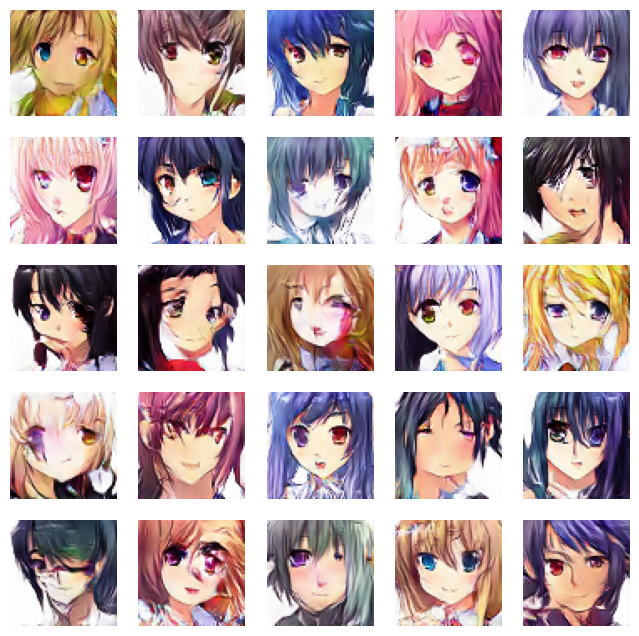

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 64ms/step - d_loss: 0.6113 - g_loss: 0.9885


In [ ]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

###Genrate new anime image

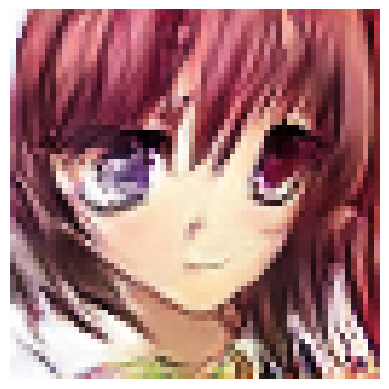

In [ ]:
noise = tf.random.normal([1,100])
plt.Figure(figsize=(2,2))
#generate the image from noise
g_img = dcgan.generator(noise)
#denormalise the image
g_img = (g_img + 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)

plt.axis('off')
plt.show()

In [ ]:
import numpy as np
import tensorflow as tf

# Generate images
def generate_images(generator, num_images, latent_dim):
    random_noise = tf.random.normal([num_images, latent_dim])
    generated_images = generator(noise, training=False)
    return (generated_images * 127.5 + 127.5).numpy().astype(np.uint8)  # Rescale to [0, 255]

num_images = 10000
generated_images = generate_images(generator, num_images, LATENT_DIM)


In [ ]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input
from scipy.stats import entropy
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import array_to_img

# Assuming your DCGAN class, generator, and LATENT_DIM are already defined as per your earlier code

# Function to calculate the Inception Score
def inception_score(images, n_split=10, eps=1E-16):
    # Load InceptionV3 model
    model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))

    # Preprocess images for InceptionV3
    images = tf.image.resize(images, (299, 299))
    images = preprocess_input(images)

    # Predict using InceptionV3
    preds = model.predict(images, batch_size=32)  # Reduce batch size if necessary

    # Split predictions into groups
    scores = []
    n_part = int(np.floor(len(preds) / n_split))
    for i in range(n_split):
        part = preds[i * n_part: (i + 1) * n_part]
        kl_div = part * (np.log(part + eps) - np.log(np.expand_dims(np.mean(part, 0), 0) + eps))
        sum_kl_div = np.mean(np.sum(kl_div, 1))
        is_score = np.exp(sum_kl_div)
        scores.append(is_score)
    return np.mean(scores), np.std(scores)

# Generate images from your DCGAN
def generate_images(generator, latent_dim, n_samples, batch_size=100):
    generated_images = []
    for _ in range(n_samples // batch_size):
        random_latent_vectors = tf.random.normal(shape=(batch_size, latent_dim))
        generated_batch = generator(random_latent_vectors, training=False)
        generated_batch = (generated_batch * 127.5) + 127.5  # De-normalize images
        generated_images.append(generated_batch.numpy())
    return np.vstack(generated_images)

# Example usage
n_samples = 1000  # Number of images to generate (reduce this if you still encounter memory issues)
batch_size = 100  # Adjust batch size to fit within memory limits

# Ensure LATENT_DIM is defined
try:
    assert 'LATENT_DIM' in globals(), "LATENT_DIM is not defined"
except AssertionError as e:
    print(e)

# Ensure generator is defined
try:
    assert 'generator' in globals(), "Generator model is not defined"
except AssertionError as e:
    print(e)

# Generate images and compute Inception Score if both LATENT_DIM and generator are properly defined
if 'LATENT_DIM' in globals() and 'generator' in globals():
    generated_images = generate_images(generator, LATENT_DIM, n_samples, batch_size)
    mean_score, std_score = inception_score(generated_images)
    print(f'Inception Score: {mean_score} ± {std_score}')
else:
    print("Make sure both LATENT_DIM and generator are correctly defined.")


32/32 ━━━━━━━━━━━━━━━━━━━━ 29s 456ms/step
Inception Score: inf ± nan
